<a href="https://colab.research.google.com/github/RonDmit/SPARTAK_n/blob/main/Ronzhin_Dmitry/Internship.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. Анализ данных и их подготовка

## Первичные данные
<pre>
1. Мы имеем 182 видео файла размер которых более 2 ГБ, значит полный объем в районе 0,5 ТБ
2. Дата первой съемки 20.04.18, дата последней съемки 27.04.23. Итого имеем 5 лет.
3. Какой-то системной периодичности съемок нет, от 3 дней, до нескольких месяцев
4. При закачке файла имеем 1 видео и архив из нескольких картинок. На сколько нам нужны именно эти картинки вопрос открытый.
5. Мы имеем видео как в летний период, так и в зимний, что может существенно повлиять на обучение и анализ
</pre>

Подгрузим первое видео и посмотрим, что он из себя представляет

In [ ]:
import cv2

# открытие видео
video_path = 'Internship/Video/DJI_0007-001.MOV'
cap = cv2.VideoCapture(video_path)
fps = cap.get(5)
width = cap.get(3)
height = cap.get(4)
print(f'Частота кадров в секунду {fsp}')
print(f'Размер изображения. Ширина {width}, Высота {height}')
print(f'Общее количество кадров в видео {cap.get(7)}')

Частота кадров в секунду 25.0
Размер изображения. Ширина 3840.0, Высота 2160.0
Общее количество кадров в видео 8596.0


Из размера картинки можно сказать, что они также занимаю много места и грузить все не имеет смысла, посмотрим сколько занимает размер картинок, где 1 картинка в 1 сек.

In [ ]:
# Создадим массив картинок
frames = []
while cap.isOpened():
    ret, frame = cap.read()
    if ret:
        # Преобразуем кадр в RGB формат
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        # Добавляем кадр в массив
        frames.append(frame)
        # Перемещаемся к следующему кадру
        cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + fps)
    else:
        break

Перевод занял достаточно много времени, проверим сколько места занимает np массив

In [ ]:
import numpy as np

# Преобразование массива в numpy массив
np_frames = np.array(frames)

# Вывод размера массива
print(np_frames.shape)

print(f'Занимает {round(np_frames.nbytes/1024/1024/1024, 2)} гигабайт')

(331, 2160, 3840, 3)
Занимает 7.67 гигабайт


In [ ]:
cap.release()

Мы имеем 331 картинки, которые занимают 7,67 гб места на диске. Каждая картинка занимает 23,7 мб.

## Подготовка данных

Работать с картинками, где они занимают 8 ГБ с одного видео не имеет смысла, поэтому проведем пару экспериментов

### Эксперимент 1
Попробуем три размера картинок меньшего размера и посмотрим как изменится размер и качество картинок

In [ ]:
# Массив с новыми размерами
size_cap = [(int(width//2), int(height//2)), (int(width//3), int(height//3)), (int(width//4), int(height//4)), (int(width//8), int(height//8))]

# Создадим массив картинок под разные размеры
frames2 = []
frames3 = []
frames4 = []
frames8 = []
frames_all = [frames2, frames3, frames4, frames8]
for i in range(4):
  if cap.isOpened(): cap.release()
  gc.collect()
  cap = cv2.VideoCapture(video_path)
  while cap.isOpened():
    ret, frame = cap.read()
    if ret:
        # Преобразуем кадр в RGB формат
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        # Изменяем размер и добавляем кадр в массив
        frame = cv2.resize(frame, size_cap[i])
        frames_all[i].append(frame)
        # Перемещаемся к следующему кадру
        cap.set(cv2.CAP_PROP_POS_FRAMES, cap.get(cv2.CAP_PROP_POS_FRAMES) + fps)
    else:
        break
cap.release()

Это также заняло не мало времени, оно не удивительно, создаются 4 массива картинок. Переведем картинки в np массив и посмотрим их вес

In [ ]:
cap.release()
import gc
np_frames_all = []
for i in range(4):
  gc.collect()
  # Преобразование массива в numpy массив
  np_frames = np.array(frames_all[i])
  np_frames_all.append(np_frames)
  # Вывод размера массива

  print(np_frames_all[i].shape)
  size = round(np_frames_all[i].nbytes/1024/1024/1024, 4)
  print(f'Занимает {size} гигабайт')
  print(f'Размер картинки занимает {round(size * 1024 / 331, 2)} мб')
  print()

(331, 1920, 1080, 3)
Занимает 1.9177 гигабайт
Размер картинки занимает 5.93 мб

(331, 1280, 720, 3)
Занимает 0.8523 гигабайт
Размер картинки занимает 2.64 мб

(331, 960, 540, 3)
Занимает 0.4794 гигабайт
Размер картинки занимает 1.48 мб

(331, 480, 270, 3)
Занимает 0.1199 гигабайт
Размер картинки занимает 0.37 мб



Как видим изменение размера значительно уменьшает размер массив. Уменьшив размер картинки в 2 раза, уменьшает объем занимаемого месте в 4 раза (2 ^ 2). Зависимость простая 3 - 9 (3 ^ 2), 4 - 16 (4 ^ 2), 8 - 64 (8 ^ 2).

Посмотрим как изменяет качество картинок. Проверим на 1500 картинке.

In [ ]:
size_cap = [(int(width//2), int(height//2)), (int(width//3), int(height//3)), (int(width//4), int(height//4)), (int(width//8), int(height//8))]

In [ ]:
# оригинальная картинка
cap = cv2.VideoCapture(video_path)
cap.set(cv2.CAP_PROP_POS_FRAMES, 1500)
ret, frame_orig = cap.read()

# Уменьшенные картинки
frame2 = cv2.resize(frame_orig, size_cap[0])
frame3 = cv2.resize(frame_orig, size_cap[1])
frame4 = cv2.resize(frame_orig, size_cap[2])
frame8 = cv2.resize(frame_orig, size_cap[3])

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline

# Функция отображения картинок
def show_images(orig, mod, names):
  count = len(orig)
  if (count != len(mod) and count != len(names)):
    print('Массивы должны одинаковое количество элементов')
    return
  figure, axs = plt.subplots(count, 2, figsize=(25, 30))
  for i in range(count):
        axs[i, 0].set_title('оригинальная картинка')
        axs[i, 0].imshow(orig[i])
        axs[i, 0].axis('off')

        axs[i, 1].set_title(names[i])
        axs[i, 1].imshow(mod[i])
        axs[i, 1].axis('off')
  plt.show()

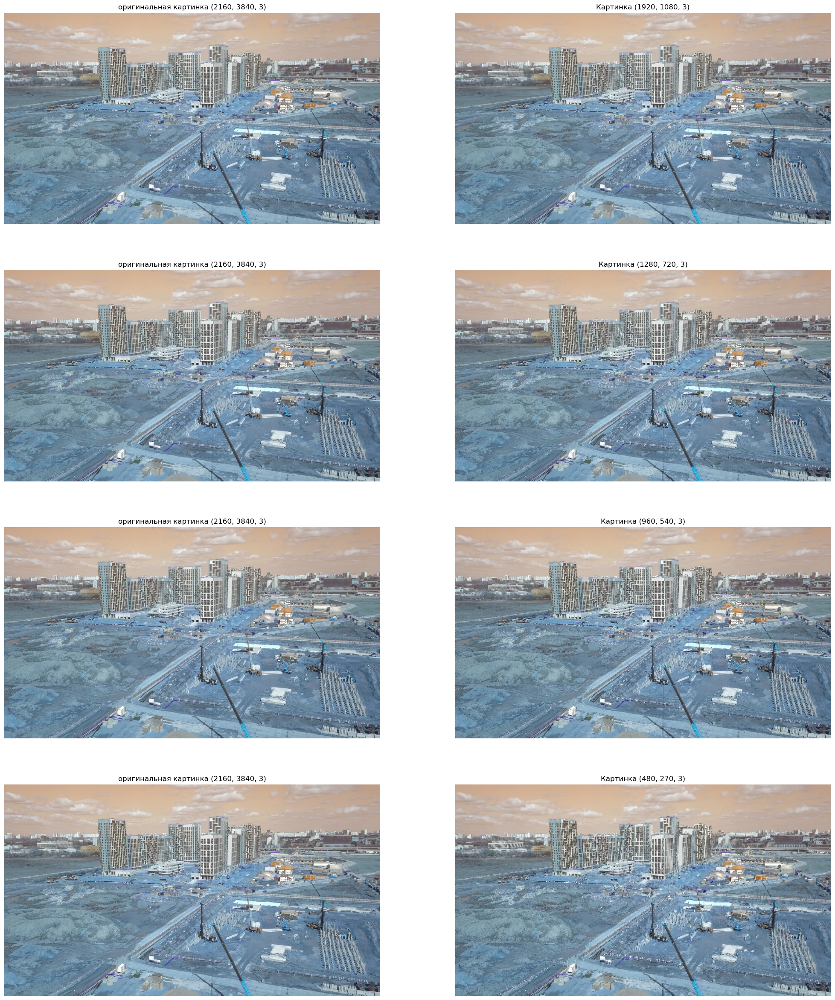

In [ ]:
# Подготовка данных
np_frame_orig = np.array(frame_orig)

orig = [np_frame_orig, np_frame_orig, np_frame_orig, np_frame_orig]

np_frame2 = np.array(frame2)
np_frame3 = np.array(frame3)
np_frame4 = np.array(frame4)
np_frame8 = np.array(frame8)

mod = [np_frame2, np_frame3, np_frame4, np_frame8]

names = ['Картинка (1920, 1080, 3)',
         'Картинка (1280, 720, 3)',
         'Картинка (960, 540, 3)',
         'Картинка (480, 270, 3)',]

# Показываем результат
show_images(orig, mod, names)

Как итог мы видим, что уменьшение в 4 раза смотрится смотрибельно, а вот уменьшение в 8 раз заметно влияет визуально на картинку

Попробуем вывести для сравнения картики в 4, 6, 8 раз. И посмотрим на другой картинке 2500

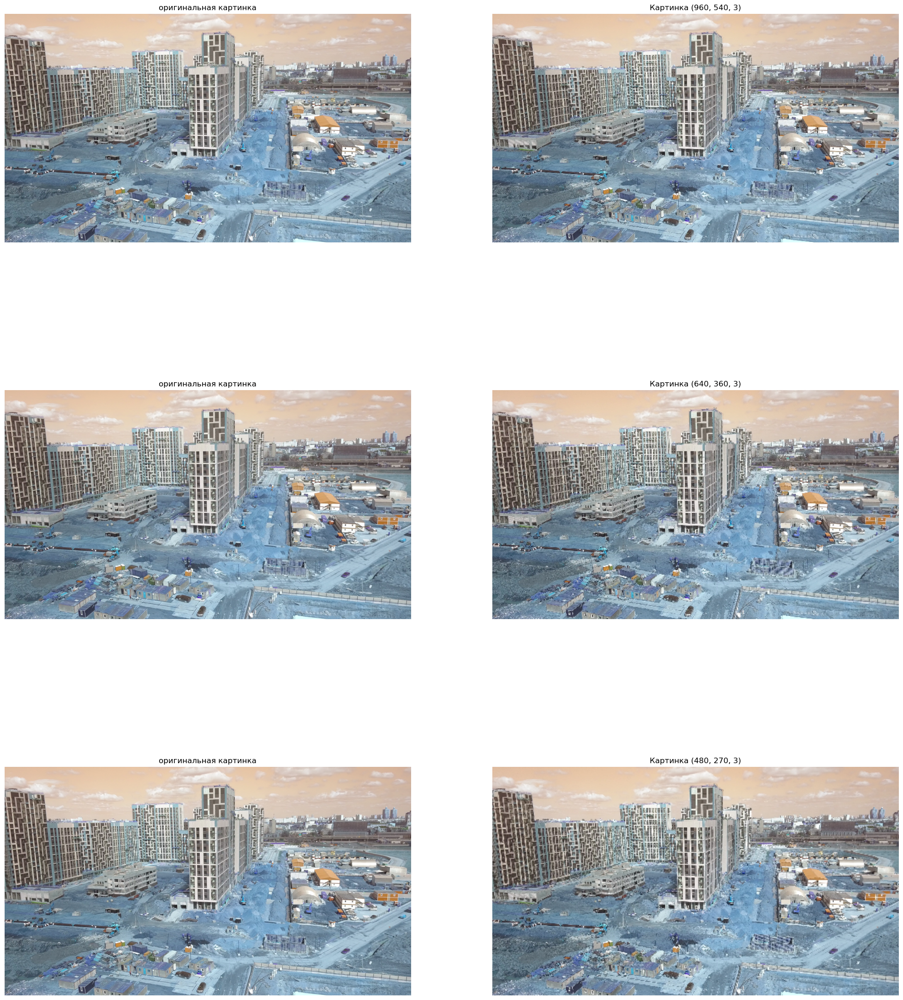

In [ ]:
# Созадим новые картики
size_cap = [(int(width//2), int(height//2)), (int(width//3), int(height//3)), (int(width//4), int(height//4)), (int(width//6), int(height//6)), (int(width//8), int(height//8))]

cap.set(cv2.CAP_PROP_POS_FRAMES, 2500)

ret, frame_orig = cap.read()
frame4 = cv2.resize(frame_orig, size_cap[2])
frame6 = cv2.resize(frame_orig, size_cap[3])
frame8 = cv2.resize(frame_orig, size_cap[4])

np_frame_orig = np.array(frame_orig)
np_frame4 = np.array(frame4)
np_frame6 = np.array(frame6)
np_frame8 = np.array(frame8)

orig = [np_frame_orig, np_frame_orig, np_frame_orig]
mod = [ np_frame4, np_frame6, np_frame8]
names = ['Картинка (960, 540, 3)',
         'Картинка (640, 360, 3)',
         'Картинка (480, 270, 3)']

# Показываем результат
show_images(orig, mod, names)

Уменьшение в 6 раз еще терпимо. Сделаем первое предположение, что уменьшение в 6 раз, является пока оптимальным

In [119]:
gc.collect()
cap.release()

### Эксперимент 2
Есть предположение, что на черно-белой, результаты могут быть лучше или по крайне мере такими же, а размер уменьшится в 3 раза. На данном этапе просто посмотрим, как визуально изменится картинка.

Подготовим картинки размера (640, 360, 3) и сравним цветную и черно-белую. Берем 500, 1500, 2500, 3500, 4500 картинки.

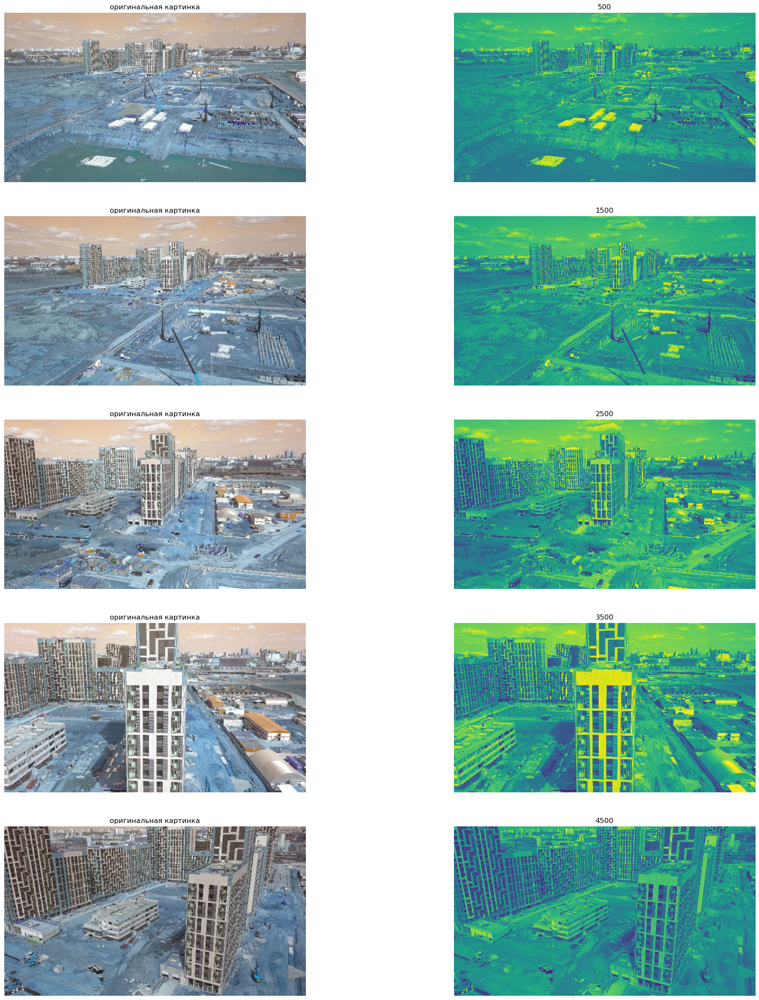

(360, 640)


In [128]:
width = 640
height = 360

cap = cv2.VideoCapture(video_path)
num_cap = [500, 1500, 2500, 3500, 4500]
cap_orig = []
cap_grey = []

for i in num_cap:
  cap.set(cv2.CAP_PROP_POS_FRAMES, i)
  _, frame_orig = cap.read()

  frame = cv2.resize(frame_orig, (width, height))
  np_frame = np.array(frame)
  cap_orig.append(np_frame)

  frame_grey = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
  np_frame = np.array(frame_grey)
  cap_grey.append(np_frame)

show_images(cap_orig, cap_grey, num_cap)
print(cap_grey[0].shape)


Не сказать, что мы теряем в качестве информативности, есть вариант попробовать использовать перевод в grey

### Эксперимент 3
Можно попробовать использовать более высокую детализацию, но разбить картинку на несколько картинов и обучать на частях, а не на целой картинке, а потом объединять информацию

Попробуем взять две картинки и разбить их на 9 частей, на  в итоге должны получить 18 картинок

In [234]:
def cut_patrs(img, parts, shape):
  line = parts[0]
  column = parts[1]

  step_width = int(shape[1] / column)
  step_height = int(shape[0] / line)

  new_frame = []

  for j in range(line):
    for i in range(column):
      new_frame.append(img[j * step_height : step_height + j * step_height,
                           i * step_width : step_width + i * step_width])
  return new_frame

In [236]:
width = 1920
height = 1080

cap = cv2.VideoCapture(video_path)

cap.set(cv2.CAP_PROP_POS_FRAMES, 1000)
_, frame1 = cap.read()
frame1 = cv2.resize(frame1, (width, height))

cap.set(cv2.CAP_PROP_POS_FRAMES, 2000)
_, frame2 = cap.read()
frame2 = cv2.resize(frame2, (width, height))

new_frame1 = cut_patrs(frame1, (2, 3), (height, width))
new_frame2 = cut_patrs(frame2, (5, 5), (height, width))

Отобразим что получилось

In [239]:
def show_part(arr_img, parts):
  line = parts[0]
  column = parts[1]
  number = 0
  figure, axs = plt.subplots(line, column, figsize=(50, 30))
  for i in range(line):
    for j in range(column):
        axs[i, j].imshow(arr_img[number])
        number += 1
        axs[i, j].set_title(f'{number} часть картинки')
        axs[i, j].axis('off')
  plt.show()

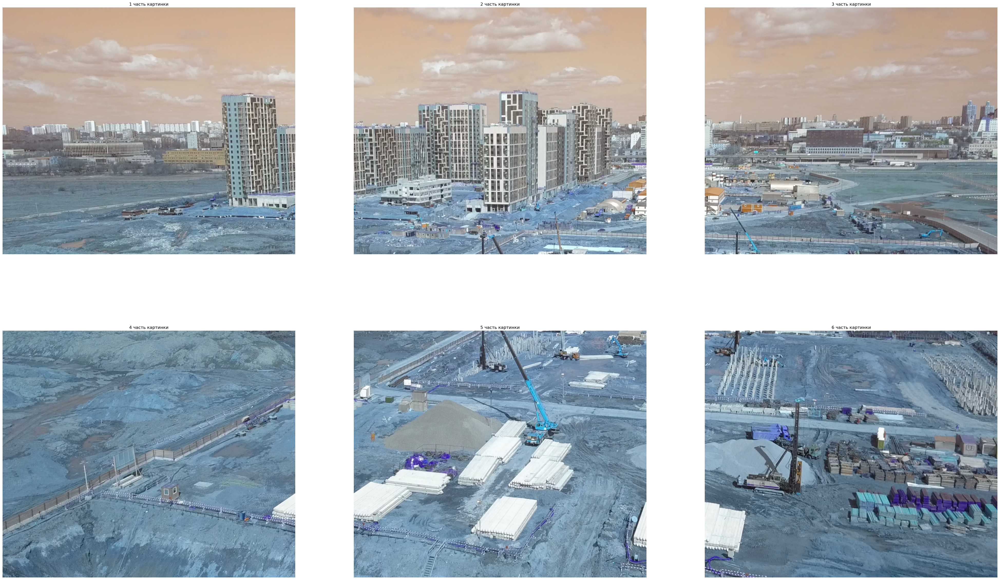

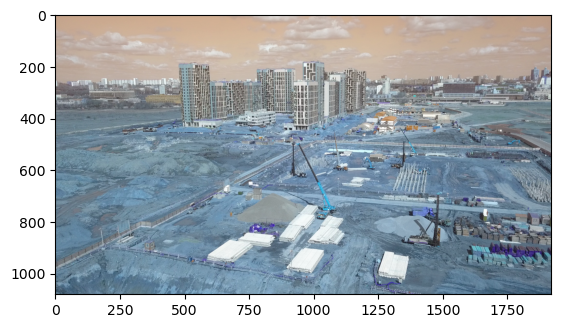

In [240]:
show_part(new_frame1, (2, 3))
plt.imshow(frame1)
plt.show(new_frame1)

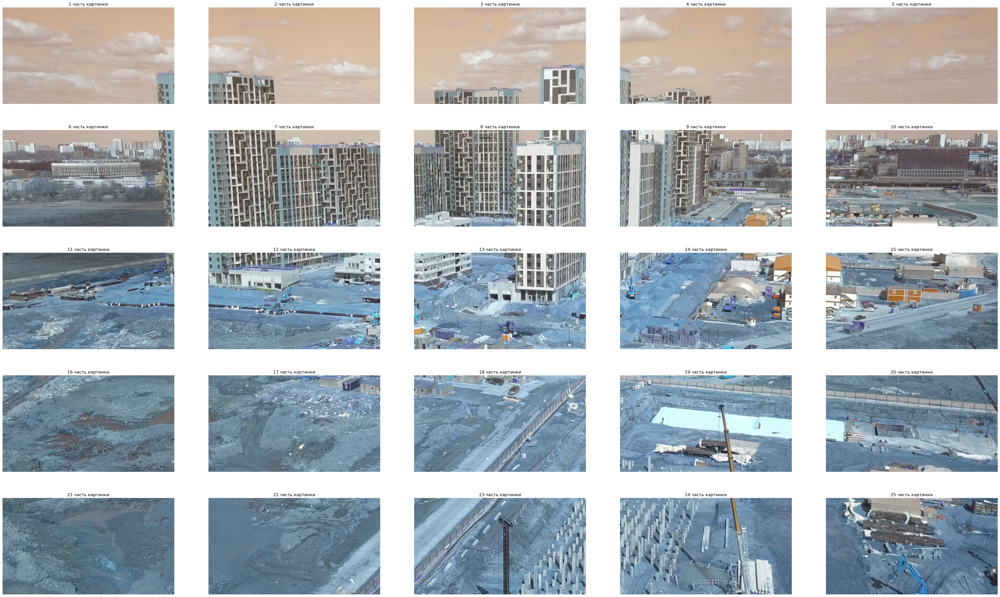

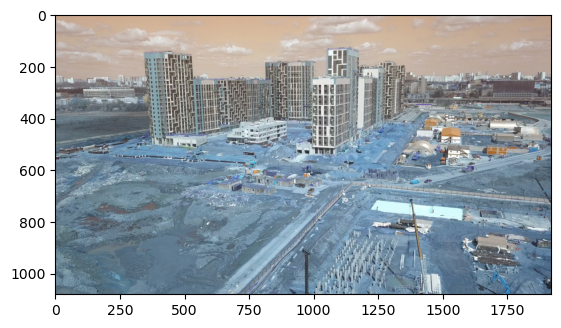

In [241]:
show_part(new_frame2, (5, 5))
plt.imshow(frame2)
plt.show()

Эксперимент достаточно интересный, мы намеренно уменьшаем количество объектов на картинке, тем самым упрощая процедуру обучения. Осталось понять как это можно использовать.